# Harry Neal - Spotify MoodGrid

*Spotify Moodgrid Playlist Subsetter is a tool to combine multiple playlists, give them a happy score and an energy score, and then output a new personal playlist centred around your chosen Happy/Energy mood.*

## Notebook 4 of 4 - MoodGrid Creation and Model Discussion

In [1]:
import numpy as np
import pandas as pd
import re
from collections import Counter

import joblib
import warnings
warnings.filterwarnings('ignore')

# For Plotting
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import os
import spotipy
from dotenv import load_dotenv
from spotipy.oauth2 import SpotifyClientCredentials
from spotipy.oauth2 import SpotifyOAuth


# Modelling
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.linear_model import LogisticRegression

from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SelectKBest, chi2, f_classif
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report


Now that we have optimised our model parameters, we can use the Happy/Sad model and the Energetic/Chilled model to give every song in our dataset a Happy score and an Energy score.

In order to get the best accuracy possible for future unseen data, let's fit the model on the complete dataset.

Load in relevant pickles

In [2]:
# pre-processed full dataset
df = joblib.load("./data/pickles/cleaned_preproc_full_df.pkl")

# matched featureset
ec_hs_features = joblib.load("./data/pickles/ec_hs_features.pkl")

# EC pipeline
ec_pipe = joblib.load("./data/pickles/EC_model_pipeline.pkl")

# HS pipeline
hs_pipe = joblib.load("./data/pickles/HS_model_pipeline.pkl")


Split into happy/sad and energetic/chill

In [3]:
df_ec = df[
    (df['playlist_mood'] == 'energetic') | (df['playlist_mood'] == 'chill')
]

df_hs = df[
    (df['playlist_mood'] == 'happy') | (df['playlist_mood'] == 'sad')
]


Split X and y for each dataset

In [4]:
y_ec = df_ec['playlist_mood']
X_ec= df_ec[ec_hs_features]

y_hs = df_hs['playlist_mood']
X_hs= df_hs[ec_hs_features]

Fit the scaling and models

In [5]:
ec_pipe.fit(X_ec, y_ec)
hs_pipe.fit(X_hs, y_hs)

Pipeline(steps=[('normalise', StandardScaler()),
                ('model',
                 LogisticRegression(C=0.01, max_iter=75, penalty='l1',
                                    solver='liblinear'))])

In [6]:
joblib.dump(ec_pipe, "./data/pickles/ec_fitted_pipeline.pkl")
joblib.dump(hs_pipe, "./data/pickles/hs_fitted_pipeline.pkl")


['./data/pickles/hs_fitted_pipeline.pkl']

Predict the probability of being an energetic song using the fitted pipeline on both datasets.  We take the second column from the array to get the energy probability as this was the predictied class 1.

In [7]:
ec_energy_proba = (ec_pipe.predict_proba(X_ec))[:,1]
hs_energy_proba = (ec_pipe.predict_proba(X_hs))[:,1]

Predict the probability of being a happy song using the fitted pipeline on both datasets.  We take the first column from the array to get the happy proba as this was the predictied class 0, and sad was class 1.

In [8]:
ec_happy_proba = hs_pipe.predict_proba(X_ec)[:,0]
hs_happy_proba = hs_pipe.predict_proba(X_hs)[:,0]

Add probabilities to their respective df

In [9]:
X_ec_proba = X_ec.copy()
X_hs_proba = X_hs.copy()

X_ec_proba['energy_proba'] = ec_energy_proba
X_hs_proba['energy_proba'] = hs_energy_proba

X_ec_proba['happy_proba'] = ec_happy_proba
X_hs_proba['happy_proba'] = hs_happy_proba

Recombine the dataframes

In [10]:
X_HS_EC = pd.concat([X_hs_proba, X_ec_proba], axis=0)

Merge the energy and happy probabilities with the original dataframe

In [11]:
X_HS_EC = X_HS_EC[['energy_proba', 'happy_proba']]

df = df.merge(X_HS_EC, how='left', left_index=True, right_index=True)

Plot the happy and energy probabilites

In [12]:
color_map = {"sad": "palevioletred", 
             "energetic": "palegoldenrod", 
             "chill": "lightskyblue", 
             "happy": "limegreen"}

fig1 = px.scatter(df, x="energy_proba", y="happy_proba", hover_data=["artists", "track_name"], height=600,width=900,opacity=0.1,
                color=df["playlist_mood"], color_discrete_map=color_map, title="MoodGrid Probability Plot",
                labels={"happy_proba": "Happy Probability",
                        "energy_proba": "Energy Probability",
                        "artists": "Artist",
                        "track_name": "Track",
                        "color": "playlist_mood"})
fig1.add_vline(x=0.5, line_width=2, line_color="black")
fig1.add_hline(y=0.5, line_width=2, line_color="black")
#Add text annotations
fig1.update_layout(annotations=[
        dict(x=0.2,y=0.8,xref="x",yref="y",text="Happy & Chilled",showarrow=False,font=dict(size=15)),
        dict(x=0.8,y=0.8,xref="x",yref="y",text="Happy & Energetic",showarrow=False,font=dict(size=15)),
        dict(x=0.2,y=0.2,xref="x",yref="y",text="Sad & Chilled",showarrow=False,font=dict(size=15)),
        dict(x=0.8,y=0.2,xref="x",yref="y",text="Sad & Energetic",showarrow=False,font=dict(size=15))])
# fig1.update_yaxes(
# range=(plotting_happy_min, plotting_happy_max),
# constrain='domain')
# fig1.update_xaxes(
# range=(plotting_energy_min, plotting_energy_max),
# constrain='domain')
# fig1.update_layout(title={'font': {'size': 15}})
fig1.show()

The plot above shows the probability of each track belonging to a particular class.  If the model predicts a song to be happy then it is above the y=0.5 line.  If the model predicts a song to be energetic then it is above the x=0.5 line.  An initial visual inspection of the data shows that the majority of Energetic songs (green) are on the right hand side, the majority of Sad songs (red) are on the bottom half, the majority of the Chilled songs (purple) are on the left half, and the majority of Happy songs (blue) are on the top half.

An area that stands out is the grouping in the bottom right corner, which upon visual inspection are exclusively songs from the metal genre.  `genre_metal` was the most influential coefficient in the Happy/Sad model, and the fourth most influential coefficient in the Energetic/Chilled model.  As this feature is either a 1 or 0, this creates a grouping where if a song is in the metal genre, then it is very likely to be both sad and energetic.

The moodgrid plotted with probabilities has a skew towards 0 and 1, especially for the metal genre grouping.  For more visually sensible values, we want to perform a transformation that centres all of the values around 0.

In [13]:
# scale happy and energy scores away from being skewed to v high or v low values
df = df.assign(happy_score = lambda x: np.log(x['happy_proba'] / (1 - x['happy_proba'])))
df = df.assign(energy_score = lambda x: np.log(x['energy_proba'] / (1 - x['energy_proba'])))

Create location variables for plotting that depend on the size of the dataset.  These can be implemented later for the interactive moodgrid that takes a new dataset every time.

In [14]:
# get min and max energy and happy score
energy_min = round(df["energy_score"].min(), 1)
energy_max = round(df["energy_score"].max(), 1)
happy_min = round(df["happy_score"].min(), 1)
happy_max = round(df["happy_score"].max(), 1)

# update min and max to be at least 1 for plotting purposes, add 0.1 so that extreme values aren't on the very edge
if energy_min > -1:
        plotting_energy_min = -1
else:
    plotting_energy_min = energy_min-0.1

if energy_max < 1:
        plotting_energy_max = 1
else:
    plotting_energy_max = energy_max+0.1

if happy_min > -1:
        plotting_happy_min = -1
else:
    plotting_happy_min = happy_min-0.1

if happy_max < 1:
        plotting_happy_max = 1
else:
    plotting_happy_max = happy_max+0.1


#update min and maxes for plotting
left_quad = plotting_energy_min/2
right_quad = plotting_energy_max/2
top_quad = plotting_happy_max/2
bottom_quad = plotting_happy_min/2

In [15]:
df.to_csv("./data/CSVs/moodgrid_df.csv")

In [109]:
color_map = {"sad": "palevioletred", 
             "energetic": "palegoldenrod", 
             "chill": "lightskyblue", 
             "happy": "limegreen"}

fig1 = px.scatter(df, x="energy_score", y="happy_score", hover_data=["artists", "track_name"], height=800,width=1600,opacity=0.1,
                color=df["playlist_mood"], color_discrete_map=color_map, title="MoodGrid shows Distribution of Playlist Moods",
                labels={"happy_score": "Happy Score",
                        "energy_score": "Energy Score",
                        "artists": "Artist",
                        "track_name": "Track",
                        "playlist_mood": "Playlist"})
fig1.add_vline(x=0, line_width=2, line_color="black")
fig1.add_hline(y=0, line_width=2, line_color="black")
# Add text annotations
fig1.update_layout(annotations=[
        dict(x=left_quad,y=top_quad,xref="x",yref="y",text="Happy & Chilled",showarrow=False,font=dict(size=18)),
        dict(x=right_quad,y=top_quad,xref="x",yref="y",text="Happy & Energetic",showarrow=False,font=dict(size=18)),
        dict(x=left_quad,y=bottom_quad,xref="x",yref="y",text="Sad & Chilled",showarrow=False,font=dict(size=18)),
        dict(x=right_quad,y=bottom_quad,xref="x",yref="y",text="Sad & Energetic",showarrow=False,font=dict(size=18))])
fig1.update_yaxes(
range=(plotting_happy_min, plotting_happy_max),
constrain='domain')
fig1.update_xaxes(
range=(plotting_energy_min, plotting_energy_max),
constrain='domain')
fig1.update_layout(title={'font': {'size': 18}})
fig1.show()

The MoodGrid after transformation has more of an even distribution and is centred on zero.  The cloud of genre_metal songs is still clear in the bottom right, although it is now spread out sparser.

### MoodGrid App

The fitted MoodGrid model can now be used to create a MoodGrid for any new song.

We have created an interactive app that reads Spotify datasets from user defined input, produces a MoodGrid for the given songs, allows the user to pick the nearest K songs to a chosen Energy and Happy score, and outputs the selected songs to a new Spotify playlist.

**./streamlit_local/moodgrid_streamlit_capstone.py**

### Analysis of Misclassified Songs

In [110]:
# Get class predictions
y_hs_pred = hs_pipe.predict(X_hs)

# Generate confusion matrix
cf_matrix = confusion_matrix(y_hs_pred, y_hs)

# label rows and columns
cf_df = pd.DataFrame(
    cf_matrix, 
    columns=["Predicted Happy", "Predicted Sad"],
    index=["True Happy", "True Sad"]
)

display(cf_df)

,Predicted Happy,Predicted Sad
True Happy,27276,14208
True Sad,9770,22118


In [111]:
report_initial = classification_report(y_hs, y_hs_pred)
print(report_initial)

              precision    recall  f1-score   support

       happy       0.66      0.74      0.69     37046
         sad       0.69      0.61      0.65     36326

    accuracy                           0.67     73372
   macro avg       0.68      0.67      0.67     73372
weighted avg       0.68      0.67      0.67     73372



The precision and recall scores give us more information on the performance of the model in where it is making prediction mistakes.

**Happy**:
- Precision = 66%: percentage of time model is correct when it predicts happy
- Recall = 74% percentage of actual happy songs that are correctly predicted

**Sad**:
- Precision = 69% percentage of time model is correct when it predicts sad
- Recall = 61% percentage of actual sad songs that are correctly predicted


In [112]:
# Get class predictions
y_ec_pred = ec_pipe.predict(X_ec)

# Generate confusion matrix
cf_matrix = confusion_matrix(y_ec_pred, y_ec)

# label rows and columns
cf_df = pd.DataFrame(
    cf_matrix, 
    columns=["Predicted Chilled", "Predicted Energetic"],
    index=["True Chilled", "True Energetic"]
)

display(cf_df)

,Predicted Chilled,Predicted Energetic
True Chilled,23656,4954
True Energetic,6831,25229


In [113]:
report_initial = classification_report(y_ec, y_ec_pred)
print(report_initial)

              precision    recall  f1-score   support

       chill       0.83      0.78      0.80     30487
   energetic       0.79      0.84      0.81     30183

    accuracy                           0.81     60670
   macro avg       0.81      0.81      0.81     60670
weighted avg       0.81      0.81      0.81     60670



The precision and recall scores give us more information on the performance of the model in where it is making prediction mistakes.

**Energetic**:
- Precision = 79%: percentage of time model is correct when it predicts energetic
- Recall = 84% percentage of actual energetic songs that are correctly predicted

**Chilled**:
- Precision = 83% percentage of time model is correct when it predicts chilled
- Recall = 78% percentage of actual chilled songs that are correctly predicted

In order to gain a sense of where the model is misclassifying songs, let's split the data into each mood and analyse if there is something systematic about the misclassifications that informs us about the modelling process.

In [114]:
# split for each mood
df_h = df[df['playlist_mood'] == 'happy']
df_s = df[df['playlist_mood'] == 'sad']
df_e = df[df['playlist_mood'] == 'energetic']
df_c = df[df['playlist_mood'] == 'chill']

Split each mood dataframe into true or misclassified.  For example if the happy score is > 0 then it is predicted as happy, and < 0 is sad.

In [115]:
h_true = df_h[df_h['happy_score'] > 0]
s_true = df_s[df_s['happy_score'] < 0]

h_misclas = df_h[df_h['happy_score'] < 0]
s_misclas = df_s[df_s['happy_score'] > 0]


e_true = df_e[df_e['energy_score'] > 0]
c_true = df_c[df_c['energy_score'] < 0]

e_misclas = df_e[df_e['energy_score'] < 0]
c_misclas = df_c[df_c['energy_score'] > 0]


Get the numerical features in a list for plotting

In [116]:
numerical_features = ['popularity', 'danceability', 'energy', 'loudness', 'mode',
       'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'duration_ms']

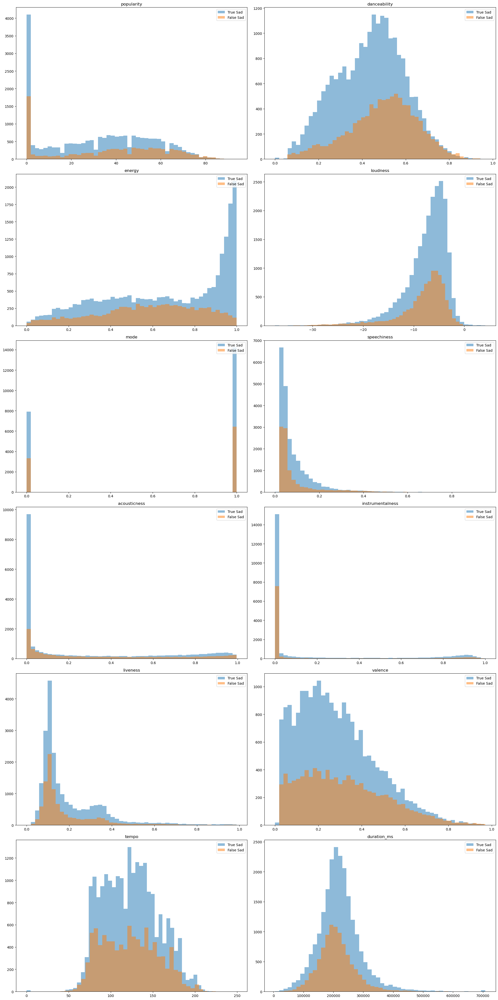

In [117]:
# Loop over the columns and plot the relationship between each column and the target
plt.subplots(6, 2, figsize=(20, 40))

count = 1

for col in numerical_features:
    plt.subplot(6, 2, count)
    plt.hist(s_true[col], bins=50, alpha=0.5, label='True Sad')
    plt.hist(h_misclas[col], bins=50, alpha=0.5, label='False Sad')
    plt.legend(loc='upper right')
    plt.title(col)
    
    count += 1
    
plt.tight_layout()
plt.show()

Comparing the distributions of True Sad songs vs False Sad songs, we see that most of the distributions are very similar.  The most noticeably different distribution is the `danceability` feature, with False predictions being skewed more towards higher danceability.  This means that the model is predicting these songs with higher danceability as being Sad, when they are truly happy.  This suggests that the model may have not placed enough weight towards low danceability as being a predictor of a Sad song, or that the relationship is too complex to be captured by a linear model.

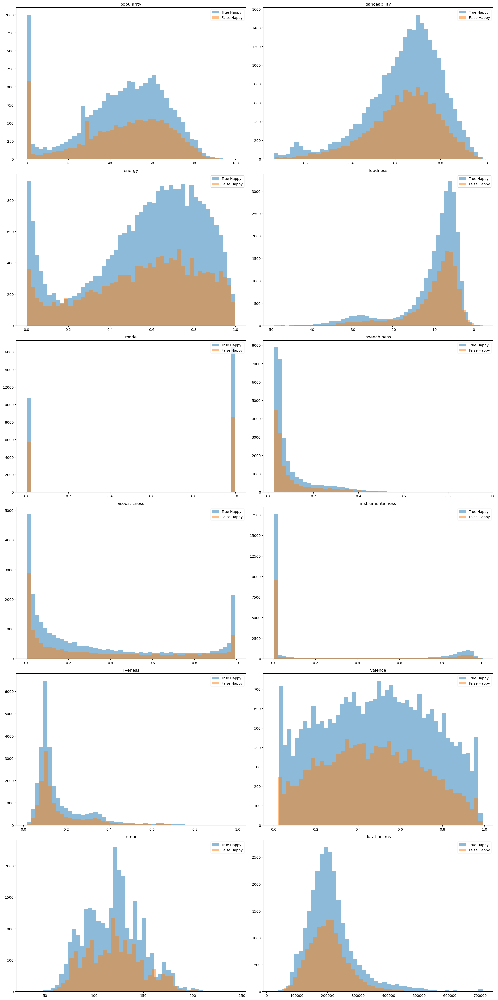

In [118]:
# Loop over the columns and plot the relationship between each column and the target
plt.subplots(6, 2, figsize=(20, 40))

count = 1

for col in numerical_features:
    plt.subplot(6, 2, count)
    plt.hist(h_true[col], bins=50, alpha=0.5, label='True Happy')
    plt.hist(s_misclas[col], bins=50, alpha=0.5, label='False Happy')
    plt.legend(loc='upper right')
    plt.title(col)
    
    count += 1
    
plt.tight_layout()
plt.show()

The numerical distributions between True Happy and False Happy songs are very similar, meaning it is not immediately clear what is causing the False Happy predictions.  It may be that more care is required in the playlist selection and labelling - this will be discussed further later.  Happiness in a song is also a very subjective feeling, and can vary from user to user.  It is possible that what evokes happiness in one user may not evoke the same feeling in others.

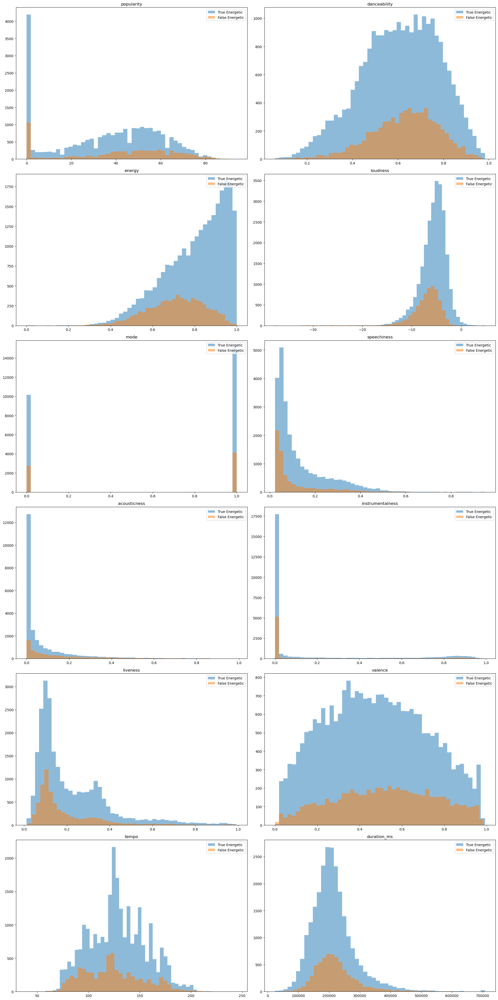

In [119]:
# Loop over the columns and plot the relationship between each column and the target
plt.subplots(6, 2, figsize=(20, 40))

count = 1



for col in numerical_features:
    plt.subplot(6, 2, count)
    plt.hist(e_true[col], bins=50, alpha=0.5, label='True Energetic')
    plt.hist(c_misclas[col], bins=50, alpha=0.5, label='False Energetic')
    plt.legend(loc='upper right')
    plt.title(col)
    
    count += 1
    
plt.tight_layout()
plt.show()

The distributions for True Energetic and False Energetic are very similar, with the biggest difference coming from the `energy` feature.  The False Energetic distribution is skewed further towards lower energies, meaning that for low Energy songs the model is Falsely predicting them to be Energetic.  This suggests that there are certain songs with low energy that are actually Energetic, and the model doesn't capture the complexity associated with the relationship that makes these songs energetic.  Perhaps more data is required to that includes more low 'energy' but energetic songs.

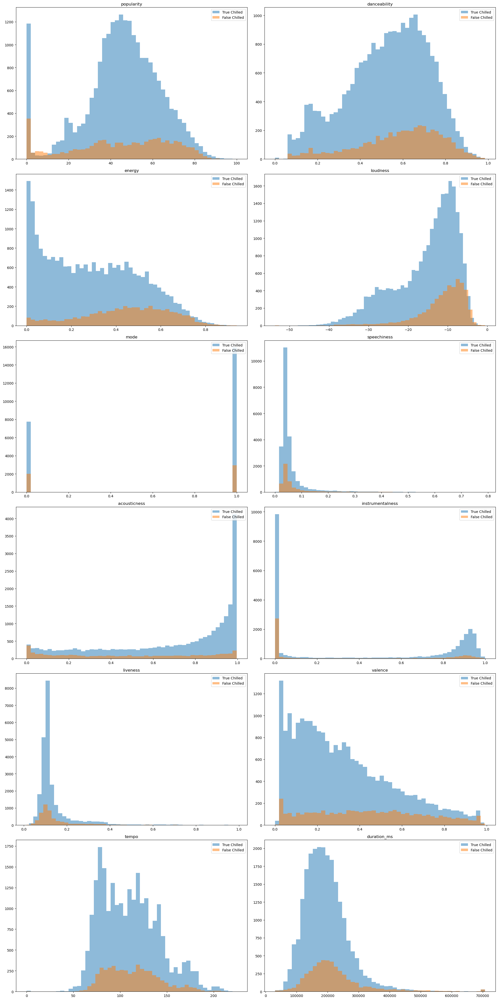

In [120]:
# Loop over the columns and plot the relationship between each column and the target
plt.subplots(6, 2, figsize=(20, 40))

count = 1



for col in numerical_features:
    plt.subplot(6, 2, count)
    plt.hist(c_true[col], bins=50, alpha=0.5, label='True Chilled')
    plt.hist(e_misclas[col], bins=50, alpha=0.5, label='False Chilled')
    plt.legend(loc='upper right')
    plt.title(col)
    
    count += 1
    
plt.tight_layout()
plt.show()

The biggest distribution differences between True Chilled and False Chilled are from `danceability`, `energy`, `loudness`.  The skew of the False chilled songs are towards higher values in all, meaning there are loud, danceable and loud songs that are labelled as chilled but are actually energetic.  Perhaps more examples of these types of songs are required in the model input, or the labels need to be investigated further to confirm their validity.

Let's look at the misclassification of songs by genre

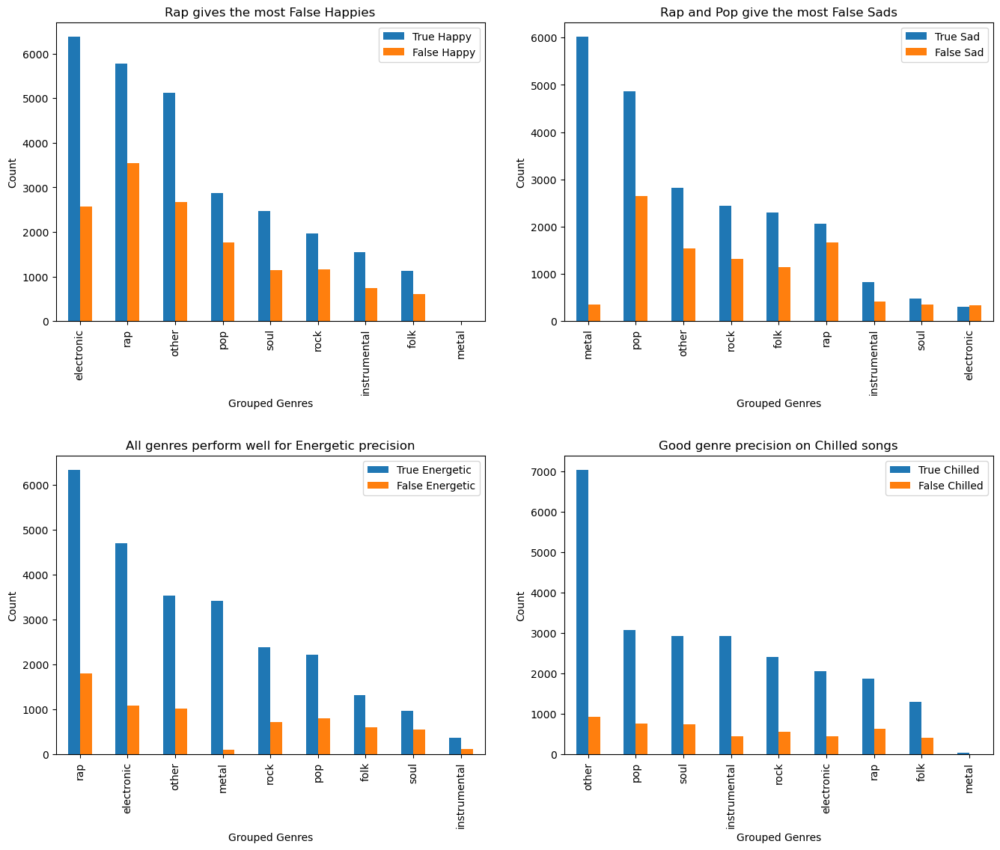

In [121]:
# Create a 2x2 grid of subplots
fig, axs = plt.subplots(2, 2, figsize=(14, 12))

# Get the value counts for each dataframe
h_true_counts = h_true['grouped_genres'].value_counts()
h_false_counts = s_misclas['grouped_genres'].value_counts()
# Combine the counts into a single dataframe
counts_df = pd.concat([h_true_counts, h_false_counts], axis=1)
counts_df.columns = ['h_true', 's_miclas']
counts_df = counts_df.fillna(0)
counts_df.plot(kind='bar', ax=axs[0, 0])
axs[0, 0].set_xlabel('Grouped Genres')
axs[0, 0].set_ylabel('Count')
axs[0, 0].legend(labels=["True Happy", "False Happy"])
axs[0, 0].set_title('Rap gives the most False Happies')

# repeat for Sad predictions
s_true_counts = s_true['grouped_genres'].value_counts()
s_false_counts = h_misclas['grouped_genres'].value_counts()
counts_df = pd.concat([s_true_counts, s_false_counts], axis=1)
counts_df.columns = ['s_true', 'h_misclas']
counts_df = counts_df.fillna(0)
counts_df.plot(kind='bar', ax=axs[0, 1])
axs[0, 1].set_xlabel('Grouped Genres')
axs[0, 1].set_ylabel('Count')
axs[0, 1].legend(labels=["True Sad", "False Sad"])
axs[0, 1].set_title('Rap and Pop give the most False Sads')

# repeat for Energetic predictions
e_true_counts = e_true['grouped_genres'].value_counts()
e_false_counts = c_misclas['grouped_genres'].value_counts()
counts_df = pd.concat([e_true_counts, e_false_counts], axis=1)
counts_df.columns = ['e_true', 'c_misclas']
counts_df = counts_df.fillna(0)
counts_df.plot(kind='bar', ax=axs[1, 0])
axs[1, 0].set_xlabel('Grouped Genres')
axs[1, 0].set_ylabel('Count')
axs[1, 0].legend(labels=["True Energetic", "False Energetic"])
axs[1, 0].set_title('All genres perform well for Energetic precision')

# repeat for Chilled predictions
c_true_counts = c_true['grouped_genres'].value_counts()
c_false_counts = e_misclas['grouped_genres'].value_counts()
counts_df = pd.concat([c_true_counts, c_false_counts], axis=1)
counts_df.columns = ['c_true', 'e_misclas']
counts_df = counts_df.fillna(0)
counts_df.plot(kind='bar', ax=axs[1, 1])
axs[1, 1].set_xlabel('Grouped Genres')
axs[1, 1].set_ylabel('Count')
axs[1, 1].legend(labels=["True Chilled", "False Chilled"])
axs[1, 1].set_title('Good genre precision on Chilled songs')

# adjust the layout of the subplots
fig.tight_layout(pad=3.0)

plt.show()


Rap gives the highest number of False Happies, with pop and other also predicting proportionally badly.  Rap and pop also give high numbers of False Sads.  This suggests that too much weight has been given to Rap and Pop as predictors of Happiness in the  modelling.  The model coefficients suggested a song being a pop song increased the probability of it being Sad, and being a rap song increased the probability of the song being happy.  Our lived experience tells us that pop and rap songs are roughly equally likely to be happy or sad, so perhaps the dataset needs to include more happy pop songs.

The proportions of False predictions for Energetic and Chilled songs are much lower, suggesting that genre is a much better predictor of Energy than it is Happiness, or at least that the coefficients reflect reality better.

#### Output the most extreme misclassification to playlists for aural analysis.

Some additional analysis was carried out by outputting the 50 'most misclassified' songs for each class to a Spotify playlist, and gaining insight on the general trends in what the model was getting wrong.

In [122]:
# Sort the values and reset the index
sorted_sad = (s_misclas['happy_score'].sort_values()).reset_index()

# get the track IDs of the 50 songs with sad labels, but with the highest happy score
s_misclas_ids = s_misclas[
    s_misclas['happy_score'] > (sorted_sad.iloc[sorted_sad.shape[0] - 51]).values[1]
][['track_id']]


# get the track IDs of the 50 songs with happy labels, but with the lowest happy score
sorted_happy = (h_misclas['happy_score'].sort_values()).reset_index()
h_misclas_ids = (h_misclas[
    h_misclas['happy_score'] < (sorted_happy.iloc[50]).values[1]
][['track_id']])


# get the track IDs of the 50 songs with chilled labels, but with the highest energy score
sorted_chilled = (c_misclas['energy_score'].sort_values()).reset_index()
c_misclas_ids = c_misclas[
    c_misclas['energy_score'] > (sorted_chilled.iloc[sorted_chilled.shape[0] - 51]).values[1]
][['track_id']]

# get the track IDs of the 50 songs with energetic labels, but with the lowest energy score
sorted_e = (e_misclas['energy_score'].sort_values()).reset_index()
e_misclas_ids = (e_misclas[
    e_misclas['energy_score'] < (sorted_e.iloc[50]).values[1]
][['track_id']])


Convert the track IDs to list format for Spotify API

In [123]:
s_mc_track_id_list = s_misclas_ids.values.tolist()
s_mc_expanded_list = []
for x in s_mc_track_id_list:
    s_mc_expanded_list.append(x[0])

h_mc_track_id_list = h_misclas_ids.values.tolist()
h_mc_expanded_list = []
for x in h_mc_track_id_list:
    h_mc_expanded_list.append(x[0])

e_mc_track_id_list = e_misclas_ids.values.tolist()
e_mc_expanded_list = []
for x in e_mc_track_id_list:
    e_mc_expanded_list.append(x[0])

c_mc_track_id_list = c_misclas_ids.values.tolist()
c_mc_expanded_list = []
for x in c_mc_track_id_list:
    c_mc_expanded_list.append(x[0])


Instantiate Spotipy session

In [124]:
# # load credentials from .env file
# load_dotenv()

# CLIENT_ID = os.getenv("CLIENT_ID", "")
# CLIENT_SECRET = os.getenv("CLIENT_SECRET", "")

# # authenticate
# client_credentials_manager = SpotifyClientCredentials(
#     client_id=CLIENT_ID, client_secret=CLIENT_SECRET
# )

# sp = spotipy.Spotify(auth_manager=SpotifyOAuth(client_id=CLIENT_ID,
#                                             client_secret=CLIENT_SECRET,
#                                             redirect_uri="http://localhost:8888/callback",
#                                             scope="playlist-modify-private"))



# user = sp.current_user()["id"]

Output false happy playlist and show track listing

https://open.spotify.com/playlist/1zVVqjvIx5O23q7qRv7Fgl?si=802a04e3b6e54d31

In [125]:
# playlist_description = f"Sad labelled songs misclassified with the highest Happy score "

# playlist = sp.user_playlist_create(user, "False Happy", public=False, description=playlist_description)

# track_list = s_mc_expanded_list

# length_of_playlist = len(track_list)

# if length_of_playlist <= 100:
#     sp.playlist_add_items(playlist["id"], track_list)
# else:
#     for i in range((length_of_playlist//100)+1):
#         sp.playlist_add_items(playlist["id"], track_list[(i*100):((i+1)*100)])
        

# new_playlist_URL = playlist['external_urls']['spotify']

In [126]:
s_misclas[
    s_misclas['happy_score'] > (sorted_sad.iloc[sorted_sad.shape[0] - 51]).values[1]
][['track_name', 'playlist_name', 'energy', 'danceability', 'loudness', 'valence']]

,track_name,playlist_name,energy,danceability,loudness,valence
31116,Party,sad,0.1830,0.803,-24.904,0.882
31120,mami,sad,0.9500,0.811,-22.882,0.764
31123,Hype,sad,0.0767,0.809,-29.657,0.580
31128,Golden street,sad,0.1110,0.803,-30.022,0.795
31133,Space,sad,0.7990,0.811,-23.081,0.898
31137,Tango,sad,0.1610,0.674,-27.412,0.612
31139,Missing,sad,0.3380,0.801,-24.407,0.962
31143,Next party,sad,0.2880,0.802,-26.050,0.548
31148,Passion,sad,0.0398,0.804,-31.342,0.670
31149,Shining,sad,0.1140,0.809,-28.999,0.831


The false happy songs could generally be categorised as either being mislabelled, or posessing some characteristic of sadness that can't be captured in the simple audio features.  For example, if we could rely on key and mode more then this would psossibly be a better indicator for these songs, and incorporating lyrics could also help with the categorisation.

Output false sad playlist and show track listing

https://open.spotify.com/playlist/2V5Pnw0xj3nFuBMlot5jl0?si=387a81a4e4994515

In [127]:
# playlist_description = f"Happy labelled songs misclassified with the lowest Happy score "

# playlist = sp.user_playlist_create(user, "False Sad", public=False, description=playlist_description)

# track_list = h_mc_expanded_list

# length_of_playlist = len(track_list)

# if length_of_playlist <= 100:
#     sp.playlist_add_items(playlist["id"], track_list)
# else:
#     for i in range((length_of_playlist//100)+1):
#         sp.playlist_add_items(playlist["id"], track_list[(i*100):((i+1)*100)])
        

# new_playlist_URL = playlist['external_urls']['spotify']

In [128]:
(h_misclas[
    h_misclas['happy_score'] < (sorted_happy.iloc[50]).values[1]
][['track_name', 'playlist_name', 'energy', 'danceability', 'loudness', 'valence']])

,track_name,playlist_name,energy,danceability,loudness,valence
2281,Drive,happy hour,0.824,0.393,-5.083,0.1010
6297,Things That Stop You Dreaming,good mornings - happily positive music to star...,0.517,0.452,-8.529,0.1900
6386,All the Little Lights,good mornings - happily positive music to star...,0.431,0.448,-11.475,0.2400
7908,Clenching Fists,ecstasy,0.985,0.544,-2.154,0.2790
9474,Let Her Go,calm happy songs,0.545,0.479,-7.346,0.2440
11470,Lyra - Broken Minds Remix,"ecstasy, pa vectrex musik",0.982,0.299,-2.197,0.0398
13226,I'm So Sick,ecstasy,0.960,0.429,-4.261,0.2330
14347,Death Blooms,ecstasy,0.974,0.275,-4.624,0.2370
14370,Going Down To Die,ecstasy,0.693,0.269,-6.686,0.2200
14425,Wester,ecstasy,0.965,0.247,-3.553,0.4830


The overall sense from the false sad playlist is that it is dominated by 'Hardcore/Hardstyle' tracks that have a sense of frantic euphoria (see track list below), but due their erratic rhythms come out with low danceability scores, and their aggressive nature results in a low valence score too.  These could be said to be genuine happy tracks of sorts but their audio features go against what our model expects from a happy track.  This could be rectified in future by attmepting to train the model on more of this genre.

There are also some metal songs that would struggle to be considered genuinely happy, their inclusion in the happy label here can be put down to a discrepancy between teh meaning of the query, 'bliss' and the intent of the playlister when creating 'blissful ignorance'.

Output false energetic playlist and show track listing

https://open.spotify.com/playlist/6jmHb9ZlDAz6nmfggtumKR?si=c288c41940514542

In [129]:
# playlist_description = f"Chilled labelled songs misclassified with the highest Energy score "

# playlist = sp.user_playlist_create(user, "False Energetic", public=False, description=playlist_description)

# track_list = c_mc_expanded_list

# length_of_playlist = len(track_list)

# if length_of_playlist <= 100:
#     sp.playlist_add_items(playlist["id"], track_list)
# else:
#     for i in range((length_of_playlist//100)+1):
#         sp.playlist_add_items(playlist["id"], track_list[(i*100):((i+1)*100)])
        

# new_playlist_URL = playlist['external_urls']['spotify']

In [130]:
c_misclas[
    c_misclas['energy_score'] > (sorted_chilled.iloc[sorted_chilled.shape[0] - 51]).values[1]
][['track_name', 'playlist_name', 'energy', 'acousticness', 'loudness', 'popularity']]

,track_name,playlist_name,energy,acousticness,loudness,popularity
81019,03' Adolescence,chill rap songs 2023 😴🍃,0.809,0.388000,-6.362,0
82764,PTSD,late night drives🏎️🍃,0.808,0.031700,-3.158,0
90450,Sun Salutations,deep house relax,0.839,0.008090,-12.527,41
91429,One of Us,mellow bars,0.808,0.090400,-5.323,53
92724,Skandalouz (ft. Nate Dogg),mellow rap 😌,0.919,0.020100,-5.054,0
92743,Gin N Juice (feat. Dat Nigga Daz),mellow rap 😌,0.853,0.028500,-4.293,7
92763,King Of N.Y. (feat. Buju Banton),mellow rap 😌,0.872,0.055500,-2.646,22
92785,Party and Bullshit - 2008 Remaster,mellow rap 😌,0.862,0.193000,-3.890,17
92794,Can't C Me,mellow rap 😌,0.852,0.043200,-2.234,0
92880,Dear Summer,mellow rap 😌,0.893,0.083800,-4.403,56


The false energetic songs contain a lot of rap, that is characterised by low acousticness and therefore with our model, a high energy.  Again, this is a sign of requiring more data in the model to capture songs that are chilled but have low acousticness.

Output false chilled playlist and track listing


https://open.spotify.com/playlist/72GbZUOTw2nqjGydCQtNmb?si=ebf9224f28754685

In [131]:
# playlist_description = f"Energetic labelled songs misclassified with the lowest Energy score "

# playlist = sp.user_playlist_create(user, "False Chilled", public=False, description=playlist_description)

# track_list = e_mc_expanded_list

# length_of_playlist = len(track_list)

# if length_of_playlist <= 100:
#     sp.playlist_add_items(playlist["id"], track_list)
# else:
#     for i in range((length_of_playlist//100)+1):
#         sp.playlist_add_items(playlist["id"], track_list[(i*100):((i+1)*100)])
        

# new_playlist_URL = playlist['external_urls']['spotify']

In [132]:
(e_misclas[
    e_misclas['energy_score'] < (sorted_e.iloc[50]).values[1]
][['track_name', 'playlist_name', 'energy', 'acousticness', 'loudness', 'popularity']])

,track_name,playlist_name,energy,acousticness,loudness,popularity
54631,Rymdresa,energy release,0.03380,0.891,-29.742,60
54632,Serene Clarity,energy release,0.03100,0.907,-33.731,59
54633,Explorer,energy release,0.00189,0.886,-38.133,64
54634,Sólestur,energy release,0.04560,0.984,-32.689,66
54635,Safe,energy release,0.03970,0.934,-25.960,54
54637,At Night I Fly,energy release,0.02930,0.985,-32.172,59
54640,We Dream,energy release,0.05560,0.987,-32.480,49
54643,Rhythms,energy release,0.06830,0.916,-30.890,58
54645,Frozen In Time,energy release,0.00752,0.932,-34.204,48
54646,Eternal Spaces,energy release,0.00109,0.950,-34.427,63


The false chilled playlist comprises almost exclusively of mislabelled playlists.  The tracks are almost all very relaxed ambient pieces, that have been included due to names such as 'energy release' and 'energy cleanse'.  This is a sign of the importance of correct labelling and being careful to quality control the automated loading processes further.

Get an aggregated happy/energy score for each query to plot on the moodgrid.

In [133]:
query_df = df.groupby(['query']).mean()[['energy_score', 'happy_score']]
query_df

,energy_score,happy_score
query,,
adrenaline,1.126582,0.094032
aggressive,1.891572,-0.023320
angriest,2.368954,-1.170952
angry,1.104328,0.064931
anguish,-1.075751,-0.356170
anguished,0.172456,0.089590
beach,0.130327,0.484153
bliss,-0.188368,0.362545
blissful,-0.168230,0.133826


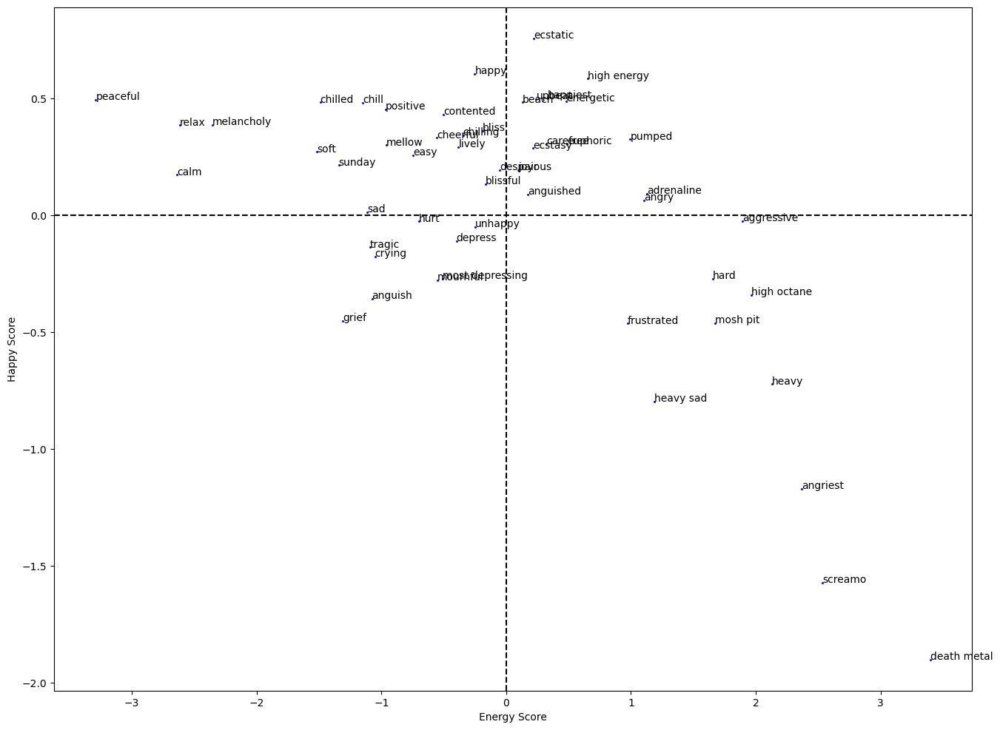

In [134]:

x = query_df['energy_score']   
y = query_df['happy_score']    
labels = query_df.index.values 

# Create a scatter plot
fig, ax = plt.subplots(figsize=(16, 12)) 
ax.scatter(x, y, s=5, marker='.', color='blue')

# Add the text labels to the markers
for i, txt in enumerate(labels):
    ax.annotate(txt, (x[i], y[i]))

# Add vertical and horizontal lines at x=0 and y=0
ax.axhline(y=0, color='k', linestyle='--')
ax.axvline(x=0, color='k', linestyle='--')

ax.set_xlabel('Energy Score')
ax.set_ylabel('Happy Score')

plt.show()

The search queries are generally placed appropriately on the MoodGrid.  In any further work, we could check how the location on the MoodGrid fits in with our own expectation of where it should sit.  The queries that stand out as being incorrectly placed are:
- despair: has a positive happy score
- melancholy: has a positive happy score
- anguished: has a positive happy score
- angry: has a positive happy score
- sad: has a slightly positive happy score

Given more time, and based on what we know about the data cleaning process, and the prevalence of playlists whose general feeling didn't fit with the intention of the search query, we would go back to the playlists under this query name and investigate whether any further cleaning or relabelling could be done.  Or alternatively more data could be added, ensuring appropriate labelling.

Some of the text labels are overlaid on each other, drop some overlapping queries for a more aesthetic plot.

In [135]:
cleaner_query_df = query_df.drop(['most depressing', 'energetic', 'chilling', 'happiest', 'carefree', 'joyous', 'beach'])

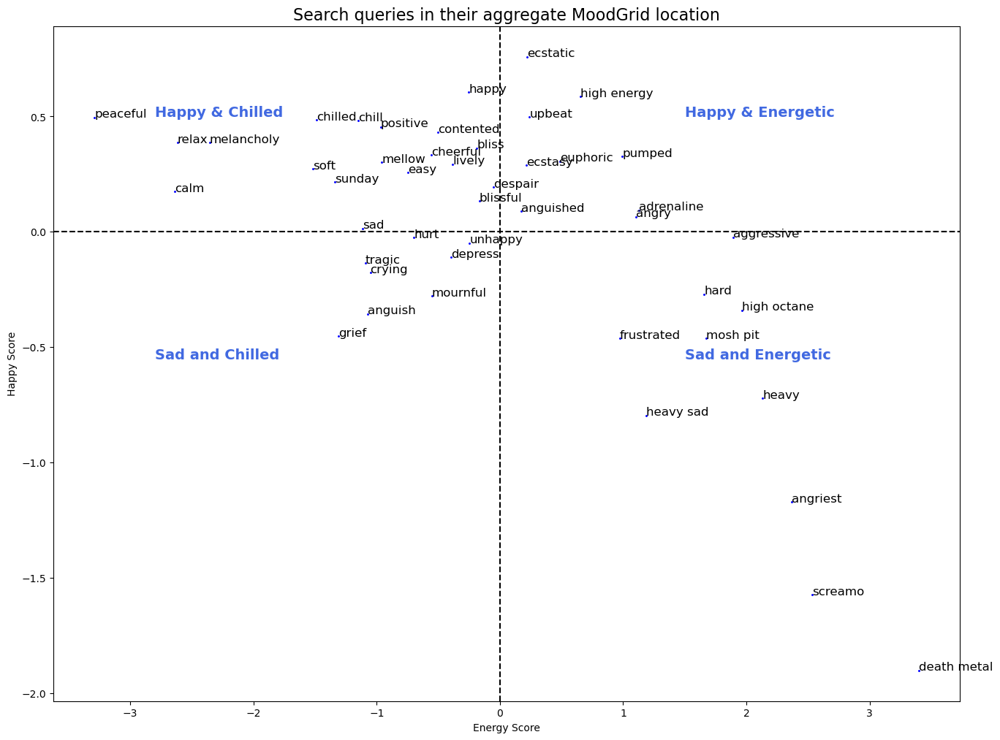

In [136]:
x = cleaner_query_df['energy_score']  
y = cleaner_query_df['happy_score']   
labels = cleaner_query_df.index.values

# Create a scatter plot
fig, ax = plt.subplots(figsize=(16, 12)) 
ax.scatter(x, y, s=5, marker='.', color='blue')

# Add the text labels to the markers
for i, txt in enumerate(labels):
    ax.annotate(txt, (x[i], y[i]), fontsize=12)

# Add vertical and horizontal lines at x=0 and y=0
ax.axhline(y=0, color='k', linestyle='--')
ax.axvline(x=0, color='k', linestyle='--')

# quadrant labels
plt.text(-2.8, 0.5, "Happy & Chilled", fontsize=14, fontweight='bold', color='royalblue')
plt.text(1.5, 0.5, "Happy & Energetic", fontsize=14, fontweight='bold', color='royalblue')
plt.text(1.5, -0.55, "Sad and Energetic", fontsize=14, fontweight='bold', color='royalblue')
plt.text(-2.8, -0.55, "Sad and Chilled", fontsize=14, fontweight='bold', color='royalblue')

ax.set_xlabel('Energy Score')
ax.set_ylabel('Happy Score')

plt.title("Search queries in their aggregate MoodGrid location", fontsize=16)
plt.show()

Aggregate genres to get an overall view of where the genres sit on the moodgrid.

In [137]:
genre_df = df.groupby('grouped_genres').mean()[['energy_score', 'happy_score']]

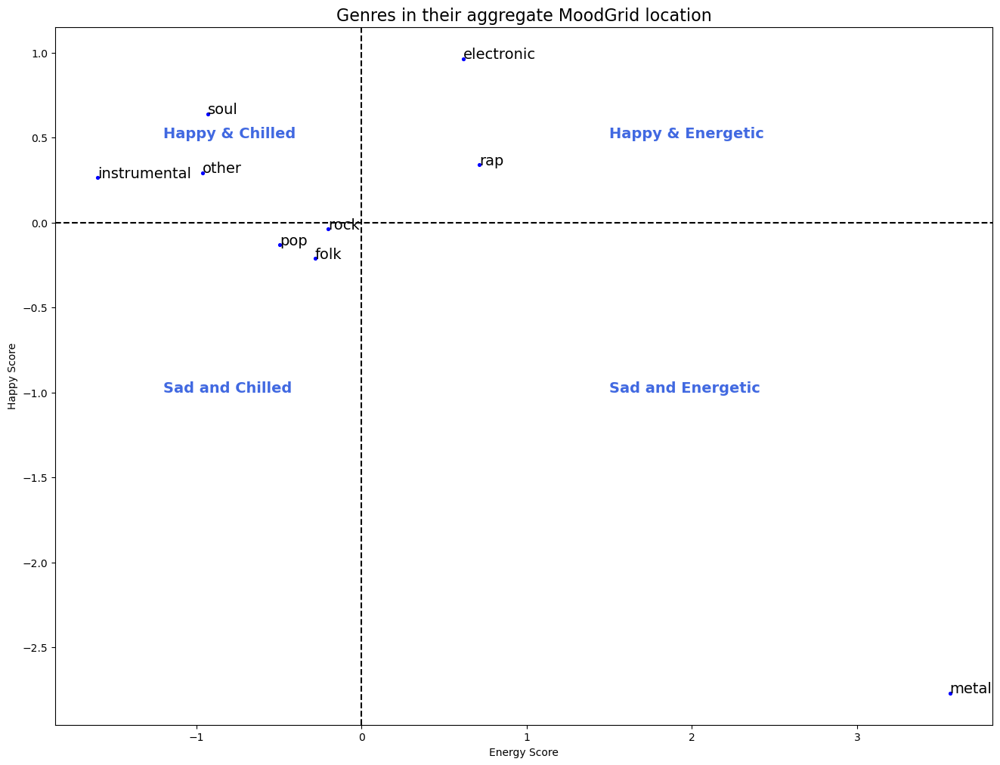

In [138]:
x = genre_df['energy_score']  
y = genre_df['happy_score']   
labels = genre_df.index.values

# Create a scatter plot
fig, ax = plt.subplots(figsize=(16, 12)) 
ax.scatter(x, y, s=30, marker='.', color='blue')

# Add the text labels to the markers
for i, txt in enumerate(labels):
    ax.annotate(txt, (x[i], y[i]), fontsize=14)

# Add vertical and horizontal lines at x=0 and y=0
ax.axhline(y=0, color='k', linestyle='--')
ax.axvline(x=0, color='k', linestyle='--')

# quadrant labels
plt.text(-1.2, 0.5, "Happy & Chilled", fontsize=14, fontweight='bold', color='royalblue')
plt.text(1.5, 0.5, "Happy & Energetic", fontsize=14, fontweight='bold', color='royalblue')
plt.text(1.5, -1, "Sad and Energetic", fontsize=14, fontweight='bold', color='royalblue')
plt.text(-1.2, -1, "Sad and Chilled", fontsize=14, fontweight='bold', color='royalblue')

ax.set_xlabel('Energy Score')
ax.set_ylabel('Happy Score')

plt.title("Genres in their aggregate MoodGrid location", fontsize=16)
plt.show()

The genres are where we would sensibly expect them, with rap possibly expected to be a little lower happiness, and metal standing out as the outlier.  Perhaps these positions, combined with what we know about the misclassification, suggests that more data is required in each of these genres.  The position of metal as a genre raises the question of whether chilled or happy metal exists, as the model has not seen any examples of these, hence why it puts so mch weight towards metal being a predictor of sad and energetic songs.  The model was possibly biased from the beginning, as the queries "screamo" and "death metal" were input with energetic or sad classes assigned, rather than just using adjectives as queries.  This is imparting on the model some preconceieved notion of what emotions 'screamo' and 'death metal' evoke, rather than using adjectives as queries, which would end up selecting moods more on the wisdom of crowds.

Without much 'happy' or 'chilled' metal for the model to work with, it is likely to perform poorly on new data if it exists in these brackets.

Select some artists for aggregated display on the MoodGrid.

In [139]:
artist_df = df.groupby('artists').mean()[['energy_score', 'happy_score']]

In [140]:
sel_artists = artist_df[
    (artist_df.index == "Fred again..") | (artist_df.index == "Taylor Swift") | 
    (artist_df.index == "FKJ") | (artist_df.index == "Kendrick Lamar") | (artist_df.index == "Owl City") |
    (artist_df.index == "The 1975") | (artist_df.index == "Pendulum") |
    (artist_df.index == "Lana Del Rey")   | (artist_df.index == "Napalm Death") |
    (artist_df.index == "Run The Jewels") | (artist_df.index == "Mac DeMarco") |
    (artist_df.index == "Metallica") | (artist_df.index == "Guns N' Roses") |
    (artist_df.index == "Nick Cave & The Bad Seeds") | (artist_df.index == "The Chemical Brothers")  |
    (artist_df.index == "Phoebe Bridgers") | (artist_df.index == "Michael Kiwanuka")  |  
    (artist_df.index == "Tom Misch")  | (artist_df.index == "Dua Lipa") | (artist_df.index == "MIKA") |
    (artist_df.index == "Burna Boy")    ]

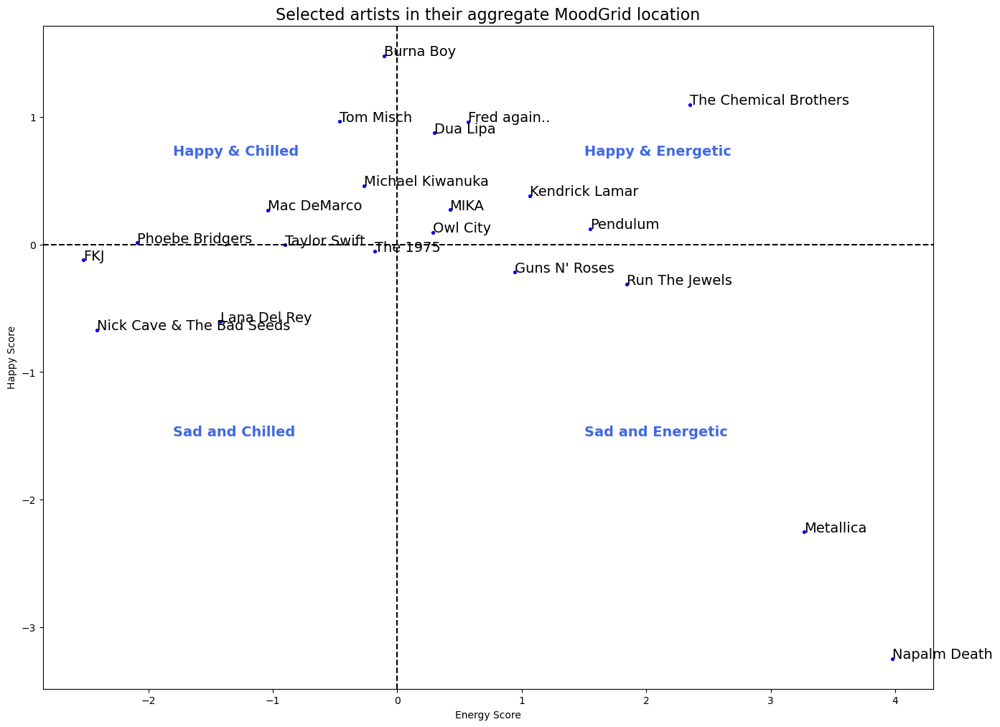

In [141]:
x = sel_artists['energy_score']  
y = sel_artists['happy_score']   
labels = sel_artists.index.values

# Create a scatter plot
fig, ax = plt.subplots(figsize=(16, 12)) 
ax.scatter(x, y, s=30, marker='.', color='blue')

# Add the text labels to the markers
for i, txt in enumerate(labels):
    ax.annotate(txt, (x[i], y[i]), fontsize=14)

# Add vertical and horizontal lines at x=0 and y=0
ax.axhline(y=0, color='k', linestyle='--')
ax.axvline(x=0, color='k', linestyle='--')

# quadrant labels
plt.text(-1.8, 0.7, "Happy & Chilled", fontsize=14, fontweight='bold', color='royalblue')
plt.text(1.5, 0.7, "Happy & Energetic", fontsize=14, fontweight='bold', color='royalblue')
plt.text(1.5, -1.5, "Sad and Energetic", fontsize=14, fontweight='bold', color='royalblue')
plt.text(-1.8, -1.5, "Sad and Chilled", fontsize=14, fontweight='bold', color='royalblue')

ax.set_xlabel('Energy Score')
ax.set_ylabel('Happy Score')

plt.title("Selected artists in their aggregate MoodGrid location", fontsize=16)
plt.show()

Judging these artists based on how we feel their output should sit, they seem to be sensibly positioned.  The metal genre issue can be seen again, as any Metallica songs with less energy, e.g. 'Nothing Else Matters', will be skewed immediately towards high energy simply for being by a Metal artist.

Perhaps using genre as a predictor gives superior accuracy on our dataset as it is, but would perform poorly on unseen data until it has been trained on a more broad spectrum of metal.

### Conclusions

The model performance on the test data of 80% on EC and 68% on HS is limited by a number of factors.

- **Noise in search results** resulting in playlists that are inappropriate for the desired mood - e.g. energy cleanse is labelled as energetic when it is relaxing ambient
- **Subjectivity of moods** - happiness and sadness is highly subjective and different songs can evoke different feelings for a variety of different reasons and lived experiences.
- **Size of dataset** - the dataset size of 150,000 songs may not capture enough of the variance in what determines a songs mood.  We have seen that the model could have benefitted from more examples of chilled rap and lighter metal so as not to create as much bias.

##### Bias

The following parts of the process could have introduced bias into the model:
- Spotify bias:  dataset is limited to Spotify only, possibly excluding less well known music from analysis
- Selection of queries: queries were chosen based on my own personal interpretation of the words and what mood they fit in, wheras some other more robust methodology could be used to select queries fairly.
- Dropping of playlists: this was done on an ad hoc basis depending on what did or didn't fit to my own ear
- Selection of genre groups:  this was done purely based on my own personal ear and tastes.  If there was some more standardised grouping it would make for more fair selection.
- Model bias: the model may be biased towards music or genres that is trained on, and perform poorly on unseen data

##### Further work
Given more time or repeat work, the following could help to gain an improved result
- Expand size of dataset - the more data used for training, the better the model will learn the patterns of predicting moods
- Additional data cleaning - more time and care could be taken to ensure playlists that do not fit into the desired query/mood are dropped from the dataset, thereby giving stronger relationships on which to base predictions.  This process could be done iteratively, creating an intial baseline MoodGrid, and using it to highlight the biggest outliers for further investigation.
- Non-linear models - testing out non-linear machine learning models could help to characterise the complex relationship between variables
- Key and Mode - the complexities of key and mode are difficult for a ML learning algorithm (Spotify's Echo Nest) to predict accurately.  But they are both heavily linked with song emotion and feeling.  An improvement in the labelling of key and mode could give further improvements to Mood prediction.
- Lyrics - the lyrics of a song carry a big part of the meaning and therefore the mood.  Incorporating lyrics from existing datasets or web-scraping could help to predict sentiment of a song and therefore the mood.
- Adding additional moods - this project has only focused on happy/sad/energetic/chilled, but the methodology could be expanded to any number of moods.

##### Acknowledgements
- Mark Wentink, Shifath Nafis, Mani Lowcock for imparting data science knowledge
- Harriet Martin for taking over household responsibilities
- Spotify, thank you for the music.